In [1]:
# imports
import os
import json
import math
import copy
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.patches as patches

In [2]:
# writes associated .dat file containing training data
def collate_training_data():
    info_file = open('info.dat', 'w')
    train_dir = 'benchmark_velocity_train/clips'

    for clip in os.listdir(train_dir):
        with open(f'{train_dir}/{clip}/annotation.json', 'r') as f:
            label = json.load(f)
           
        info_line = f'{train_dir}/{clip}/imgs/040.jpg {len(label)}'
        
        for label_bounds in label:
            bbox = label_bounds['bbox']

            # take extremities of bbox
            left = math.floor(bbox['left'])
            right = math.ceil(bbox['right'])
            top = math.floor(bbox['top'])
            bot = math.ceil(bbox['bottom'])
            width = right - left
            height = bot - top
        
            info_line += f' {left} {top} {width} {height}'
            
        info_file.write(info_line + '\n')
        
    info_file.close()
      
# writes associated .dat file containing negative data
def collate_negative_data():
    negatives_file = open('negatives.dat', 'w')
    negatives_dir = 'negatives'

    for img_name in os.listdir(negatives_dir):
        negatives_file.write(f'../../../../../project/{negatives_dir}/{img_name}\n')
        
    negatives_file.close()

collate_training_data()
collate_negative_data()

In [3]:
def detect_and_display(img_name, show_img=False):
    img = cv2.imread(img_name)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    gray = cv2.equalizeHist(gray)

    vehicle_cascade = cv2.CascadeClassifier('classifier/cascade.xml')
    bboxes = vehicle_cascade.detectMultiScale(gray)
    
    # obtain and save bbox
    preds = []
    for (left, top, width, height) in bboxes:
        right = left + width
        bot = top + height
        preds.append((left, right, top, bot))
        cv2.rectangle(img, (left, top),(right, bot), (255,0,0), 3)
    
    # draw bbox from previously specified box
    if show_img:
        plt.imshow(img)
        plt.axis('off')
        plt.show()
        
    return preds

In [4]:
def has_overlap(pred, gt):
    p_left, p_right, p_top, p_bot = pred
    gt_left, gt_right, gt_top, gt_bot = gt
    # if either dimension does not overlap
    if p_left >= gt_right or gt_left >= p_right or p_top >= gt_bot or gt_top >= p_bot:
        return False
    return True

def calc_iou(pred, gt):
    p_left, p_right, p_top, p_bot = pred
    gt_left, gt_right, gt_top, gt_bot = gt

    # calculate individual areas
    p_area = (p_right - p_left) * (p_bot - p_top)
    gt_area = (gt_right - gt_left) * (gt_bot - gt_top)

    # calculate intersection area
    inter_width = min(p_right, gt_right) - max(p_left, gt_left)
    inter_height = min(p_bot, gt_bot) - max(p_top, gt_top)
    inter_area = inter_width * inter_height if inter_width > 0 and inter_height > 0 else 0
    
    # calculate union area
    union_area = p_area + gt_area - inter_area
    
    return inter_area / union_area

def evaluate_results(preds, gts):
    iou_sum, total_detected = 0, 0
    # calculate IoU for each result
    for pred in preds:
        iou_list = [calc_iou(pred, gt) for gt in gts if has_overlap(pred, gt)]
        iou_sum += sum(iou_list)
        total_detected += len(iou_list)

    return iou_sum / total_detected if total_detected else 0 

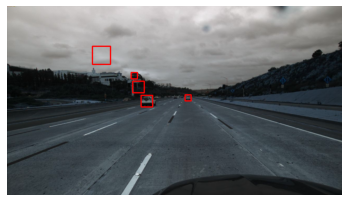

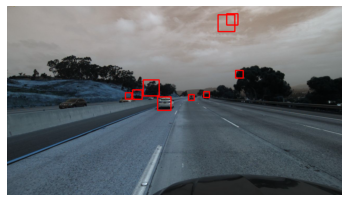

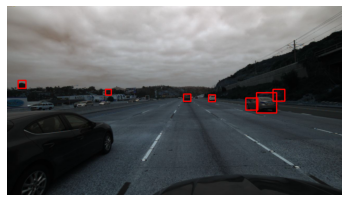

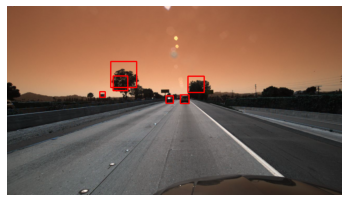

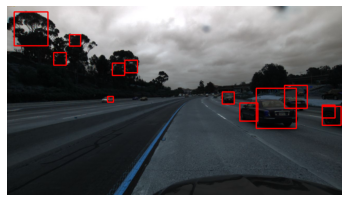

...

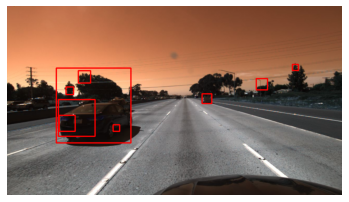

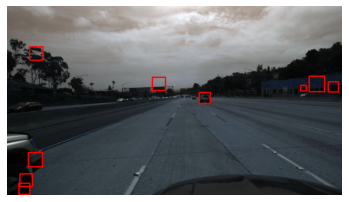

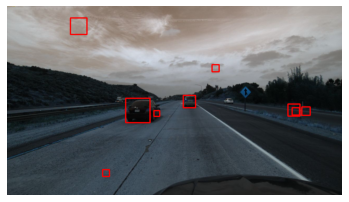

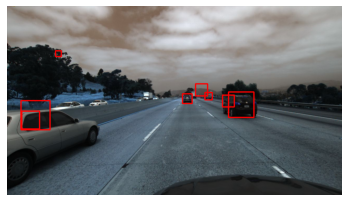

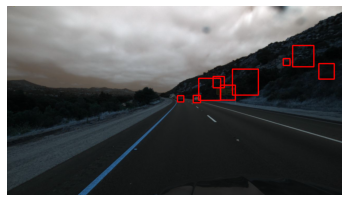

In [7]:
def run_classifier(show_img=False):
    results = []
    test_dir = 'benchmark_velocity_test/clips'
    for clip in os.listdir(test_dir):
        # collate predictions
        img_file = f'{test_dir}/{clip}/imgs/040.jpg'
        preds = detect_and_display(img_file, show_img)
        
        # collate ground truths
        with open(f'{test_dir}/{clip}/annotation.json', 'r') as f:
            label = json.load(f)
            
        gts = []
        for label_bounds in label:
            bbox = label_bounds['bbox']

            # take extremities of bbox
            left = math.floor(bbox['left'])
            right = math.ceil(bbox['right'])
            top = math.floor(bbox['top'])
            bot = math.ceil(bbox['bottom'])
            gts.append((left, right, top, bot))
            
        results.append((preds, gts))
    
    return results

results = run_classifier(True)

In [6]:
def evaluate_classifier(results):
    iou_list = []
    for (preds, gts) in results:
        iou_list.append(evaluate_results(preds, gts))
        
    return sum(iou_list)/len(iou_list)
    
print(f'Classifier IoU value: {evaluate_classifier(results)}')

Classifier IoU value: 0.637242250362444
